# Air Pollution: Exploratory Data Analysis (EDA)

In this notebook we will explore the air pollution training data for our joint machine learning project. 

Source: [ZINDI](https://zindi.africa/competitions/zindiweekendz-learning-urban-air-pollution-challenge/data)

<blockquote> 
The objective of this challenge is to predict PM2.5 particulate matter concentration in the air every day for each city. 

```PM2.5``` refers to atmospheric particulate matter that have a diameter of less than 2.5 micrometers and is one of the most harmful air pollutants. ```PM2.5``` is a common measure of air quality that normally requires ground-based sensors to measure. The data covers the last three months, spanning hundreds of cities across the globe.

The data comes from three main sources:

- Ground-based air quality sensors. These measure the target variable (PM2.5 particle concentration). In addition to the target column (which is the daily mean concentration) there are also columns for minimum and maximum readings on that day, the variance of the readings and the total number (count) of sensor readings used to compute the target value. This data is only provided for the train set - you must predict the target variable for the test set.

- The Global Forecast System (GFS) for weather data. Humidity, temperature and wind speed, which can be used as inputs for your model.

- The Sentinel 5P satellite. This satellite monitors various pollutants in the atmosphere. For each pollutant, we queried the offline Level 3 (L3) datasets available in Google Earth Engine (you can read more about the individual products here: https://developers.google.com/earth-engine/datasets/catalog/sentinel-5p). For a given pollutant, for example NO2, we provide all data from the Sentinel 5P dataset for that pollutant. This includes the key measurements like NO2_column_number_density (a measure of NO2 concentration) as well as metadata like the satellite altitude. We recommend that you focus on the key measurements, either the column_number_density or the tropospheric_X_column_number_density (which measures density closer to Earth’s surface).

Unfortunately, this data is not 100% complete. Some locations have no sensor readings for a particular day, and so those rows have been excluded. There are also gaps in the input data, particularly the satellite data for CH4.

</blockquote>

## Set up 

In [38]:
# Import packages

# basics
import pandas as pd
import numpy as np

# plotting
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('white')
sns.set_palette('magma')


# warnings
import warnings
warnings.filterwarnings('ignore')


## Load data

In [39]:
# load training data
df = pd.read_csv('data/Train.csv')

## Explore data frame

In [5]:
df.head()

,Place_ID X Date,Date,Place_ID,target,target_min,target_max,target_variance,target_count,precipitable_water_entire_atmosphere,relative_humidity_2m_above_ground,...,L3_SO2_sensor_zenith_angle,L3_SO2_solar_azimuth_angle,L3_SO2_solar_zenith_angle,L3_CH4_CH4_column_volume_mixing_ratio_dry_air,L3_CH4_aerosol_height,L3_CH4_aerosol_optical_depth,L3_CH4_sensor_azimuth_angle,L3_CH4_sensor_zenith_angle,L3_CH4_solar_azimuth_angle,L3_CH4_solar_zenith_angle
0,010Q650 X 2020-01-02,2020-01-02,010Q650,38.0,23.0,53.0,769.50,92,11.000000,60.200001,...,38.593017,-61.752587,22.363665,1793.793579,3227.855469,0.010579,74.481049,37.501499,-62.142639,22.545118
1,010Q650 X 2020-01-03,2020-01-03,010Q650,39.0,25.0,63.0,1319.85,91,14.600000,48.799999,...,59.624912,-67.693509,28.614804,1789.960449,3384.226562,0.015104,75.630043,55.657486,-53.868134,19.293652
2,010Q650 X 2020-01-04,2020-01-04,010Q650,24.0,8.0,56.0,1181.96,96,16.400000,33.400002,...,49.839714,-78.342701,34.296977,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,010Q650 X 2020-01-05,2020-01-05,010Q650,49.0,10.0,55.0,1113.67,96,6.911948,21.300001,...,29.181258,-73.896588,30.545446,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,010Q650 X 2020-01-06,2020-01-06,010Q650,21.0,9.0,52.0,1164.82,95,13.900001,44.700001,...,0.797294,-68.612480,26.899694,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
df.shape

(30557, 82)

In [41]:
df.Place_ID.nunique()

340

In [40]:
df.groupby("Place_ID").describe()

target                                                            
          count        mean        std   min    25%   50%     75%    max   
Place_ID                                                                   
010Q650    94.0   37.063830  13.343122  13.0  24.00  38.0   48.00   61.0  \
05EC30X    90.0   39.322222  16.143895  13.0  25.00  38.0   50.00   80.0   
0DPWHX8    94.0   79.904255  30.385717  23.0  59.00  76.0   96.00  161.0   
0GBXTHY    94.0   16.329787   7.416037   7.0  11.00  14.0   18.00   41.0   
0HYPV1N    94.0   87.946809  32.556772  50.0  61.00  77.0  112.00  162.0   
...         ...         ...        ...   ...    ...   ...     ...    ...   
YLLOKEY    94.0   27.510638  17.245068   4.0  17.00  22.0   31.75   89.0   
YLZOBFW    94.0   22.744681  15.259713   4.0  12.00  20.0   28.75   74.0   
YPXSK14    94.0  125.223404  95.321770  25.0  57.00  86.0  166.50  465.0   
YSIXKFZ    94.0   28.382979  17.579378   4.0  17.00  24.0   31.75   93.0   
YWSFY6Q    78.0   69.692308  39.163098  16.0  36.75  59.5   97.75  157.0   

         target_min             ... L3_CH4_solar_azimuth_angle               
              count       mean  ...                        75%         max   
Place_ID                        ...                                          
010Q650        94.0  21.021277  ...                        0.0    0.000000  \
05EC30X        90.0  22.855556  ...                        0.0    0.000000   
0DPWHX8        94.0  61.882979  ...                        0.0    0.000000   
0GBXTHY        94.0   1.691489  ...                        0.0    0.000000   
0HYPV1N        94.0  24.127660  ...                        0.0    0.000000   
...             ...        ...  ...                        ...         ...   
YLLOKEY        94.0  13.904255  ...                        0.0  176.717438   
YLZOBFW        94.0   6.063830  ...                        0.0    0.000000   
YPXSK14        94.0  70.648936  ...                        0.0    0.000000   
YSIXKFZ        94.0  14.617021  ...                        0.0    0.000000   
YWSFY6Q        78.0  40.576923  ...                        0.0  176.984371   

         L3_CH4_solar_zenith_angle                                              
                             count       mean        std  min  25%        50%   
Place_ID                                                                        
010Q650                       23.0  24.228819  21.406263  0.0  0.0  24.592866  \
05EC30X                       19.0  13.903494  14.402551  0.0  0.0  17.237051   
0DPWHX8                       18.0  26.783144  27.807641  0.0  0.0  22.424010   
0GBXTHY                        9.0   0.000000   0.000000  0.0  0.0   0.000000   
0HYPV1N                        9.0   0.000000   0.000000  0.0  0.0   0.000000   
...                            ...        ...        ...  ...  ...        ...   
YLLOKEY                       12.0  13.969465  25.681690  0.0  0.0   0.000000   
YLZOBFW                       14.0  23.243089  32.407301  0.0  0.0   0.000000   
YPXSK14                       10.0   4.509750  14.261080  0.0  0.0   0.000000   
YSIXKFZ                       13.0  17.001928  26.903709  0.0  0.0   0.000000   
YWSFY6Q                       16.0  29.437198  30.743929  0.0  0.0  24.956155   

                                
                75%        max  
Place_ID                        
010Q650   43.770055  53.573624  
05EC30X   25.094024  39.061607  
0DPWHX8   53.418321  60.957225  
0GBXTHY    0.000000   0.000000  
0HYPV1N    0.000000   0.000000  
...             ...        ...  
YLLOKEY   12.371842  68.252692  
YLZOBFW   62.330949  68.662293  
YPXSK14    0.000000  45.097496  
YSIXKFZ   49.824393  68.307175  
YWSFY6Q   59.660584  66.012327  

[340 rows x 632 columns]

# Missing data
Let's explore the amount of missing data for all of our features. 

In [9]:
! pip install missingno
import missingno as msno

<Axes: >

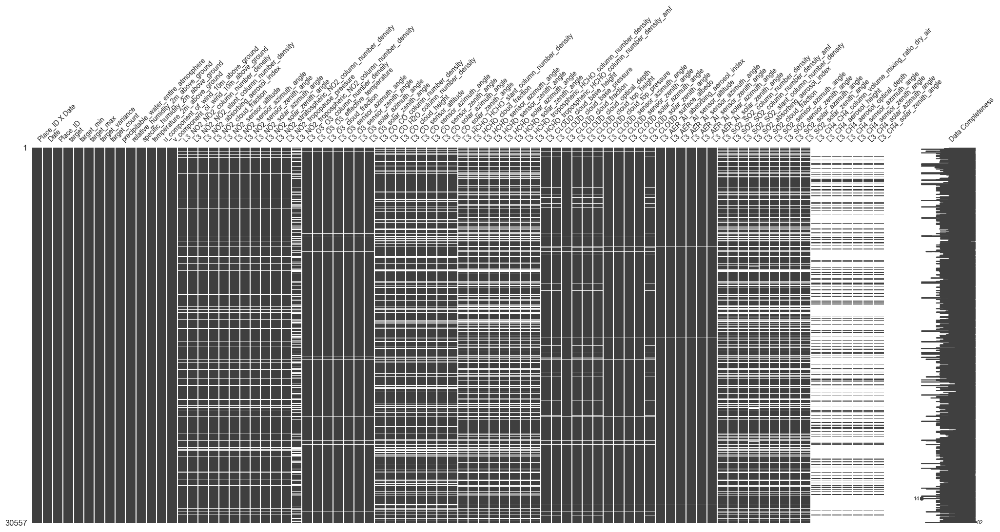

In [10]:
msno.matrix(df, fontsize=10,labels=True)

From the missingno matrix figure, it is clear that there is only missing data for the satellite data, not for the target or close-to-the-ground measurements. The amount of missing satellite data (```L3```) is clearly related to the pollutant, with only very sparse methane (```CHO4```) data.

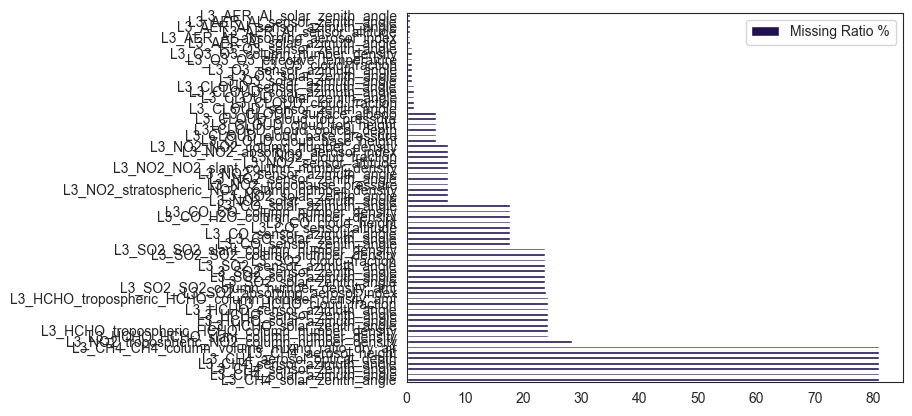

In [11]:
# plot percentage of missing instances with labels
# from: https://stackoverflow.com/questions/69537383/how-to-plot-count-of-null-values-for-each-column-in-pandas-dataframe
import matplotlib.pyplot as plt
def plot_nas(df: pd.DataFrame):
    if df.isnull().sum().sum() != 0:
        na_df = (df.isnull().sum() / len(df)) * 100      
        na_df = na_df.drop(na_df[na_df == 0].index).sort_values(ascending=False)
        missing_data = pd.DataFrame({'Missing Ratio %' :na_df})
        missing_data.plot(kind = "barh")
        plt.show()
    else:
        print('No NAs found')
plot_nas(df)
plot_width, plot_height = (15,15)
plt.rcParams['figure.figsize'] = (plot_width,plot_height)
plt.rcParams['ytick.labelsize'] = 9

Looking at the percentages of missing data, we are missing little over 80% data for methane (```CH4```), and up to 25% for formaldehyde (```HCHO```) and sulferdioxide (```SO2```). For carbonmonoxide (```CO```), most nitrogen oxide measurements (```NO2```), cloud (```CLOUD```), ozone (```O3```), and aerosols (```AER```). Given the size of the dataset, we may still be able to include these data in the initial model. However, it may be relevant to look for patterns in the missing satellite data, especially, if this may be meaningful for our business case. Is there a pattern? Is it perhaps weather-related that we can't get satellite measurements? 


# Check balance of the target variable

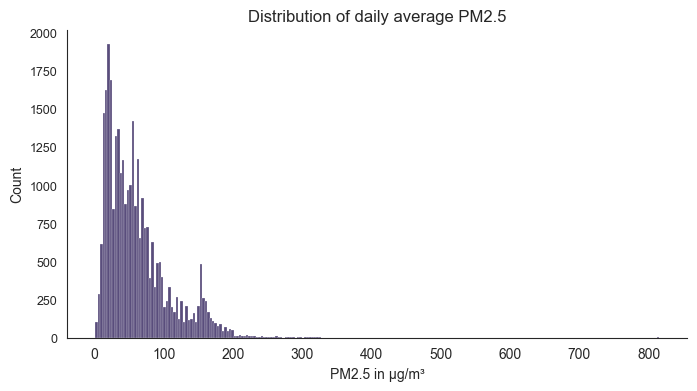

In [12]:
plt.subplots(figsize=(8, 4))
ax = sns.histplot(x=df.target, stat='count', edgecolor='white')
ax.set(xlabel="PM2.5 in µg/m³", title="Distribution of daily average PM2.5")
sns.despine()


In [13]:
# Create target categories based on https://www.epa.vic.gov.au/for-community/environmental-information/air-quality/pm25-particles-in-the-air
bins = [0, 12.5, 25, 50, 150, np.inf]
health_cat = ['good', 'fair','poor','very poor','extremely poor']
df['target_cat'] = pd.cut(df['target'], bins, labels = health_cat)

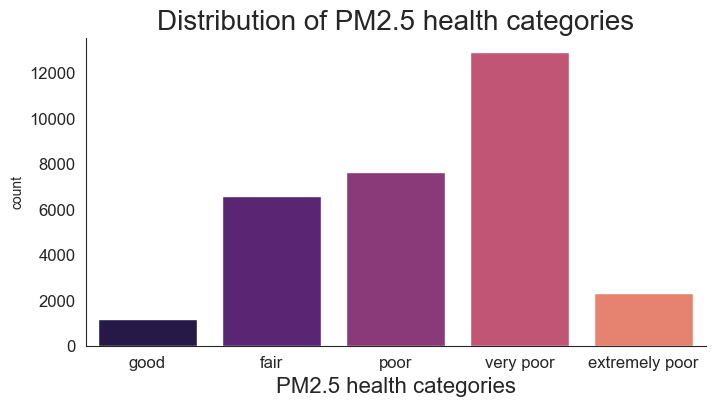

In [14]:
# Check distribution of target categories
plt.subplots(figsize=(8, 4))

ax = sns.countplot(x=df.target_cat)
ax.set_title("Distribution of PM2.5 health categories", fontsize=20)
ax.set_xlabel("PM2.5 health categories", fontsize=16)
ax.tick_params(labelsize=12)

sns.despine()


# Check correlations between features

In [16]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_score, recall_score, roc_auc_score, roc_curve, f1_score
from sklearn.preprocessing import power_transform

RSEED = 42

In [17]:
X = df.select_dtypes(['number'])
y = df['target']

In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = RSEED)

<Axes: xlabel='target', ylabel='Count'>

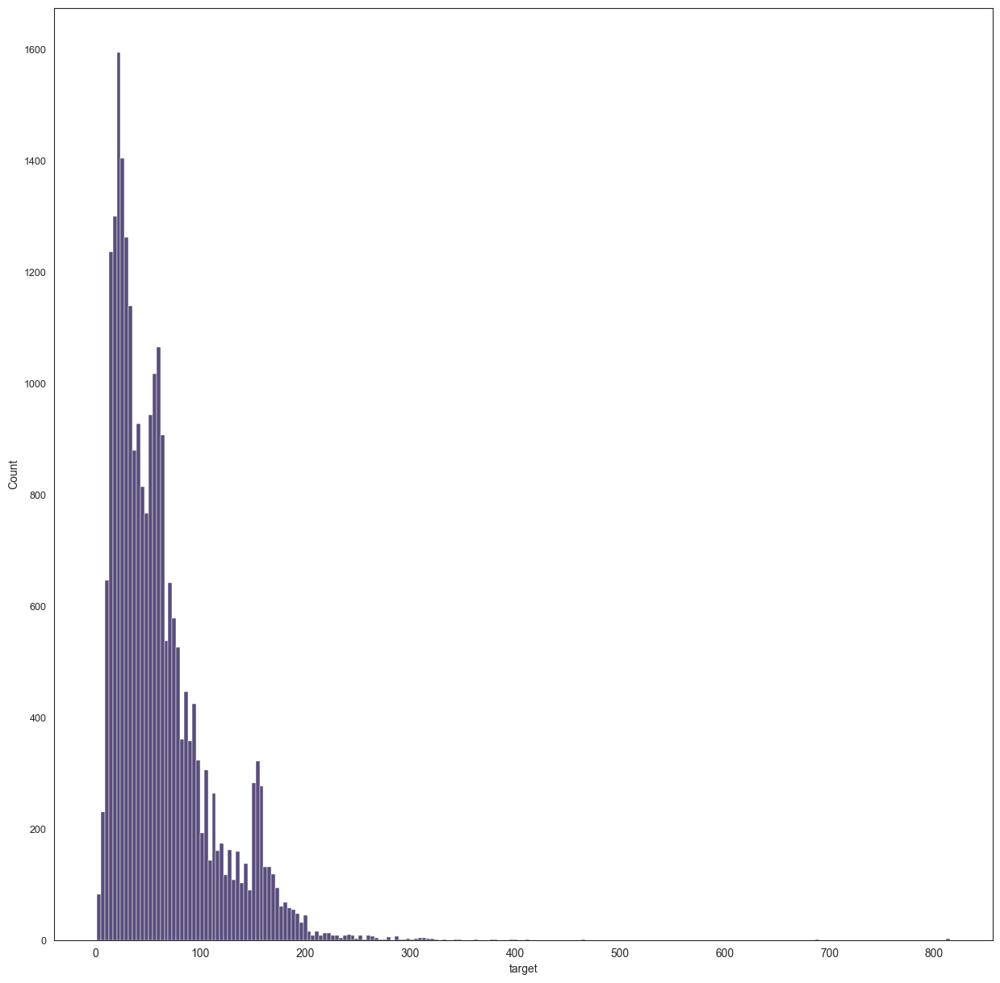

In [19]:
sns.histplot(y_train)

In [ ]:
y = df['target']

0         38.0
1         39.0
2         24.0
3         49.0
4         21.0
         ...  
30552     22.0
30553     53.0
30554     85.0
30555    103.0
30556     89.0
Name: target, Length: 30557, dtype: float64

In [28]:
y_train_trans = power_transform(df['target'],method='box-cox')

ValueError: Expected 2D array, got 1D array instead:
array=[ 38.  39.  24. ...  85. 103.  89.].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [ ]:
from scipy import stats
yt_train = stats.boxcox(y_train)#


<Axes: ylabel='Count'>

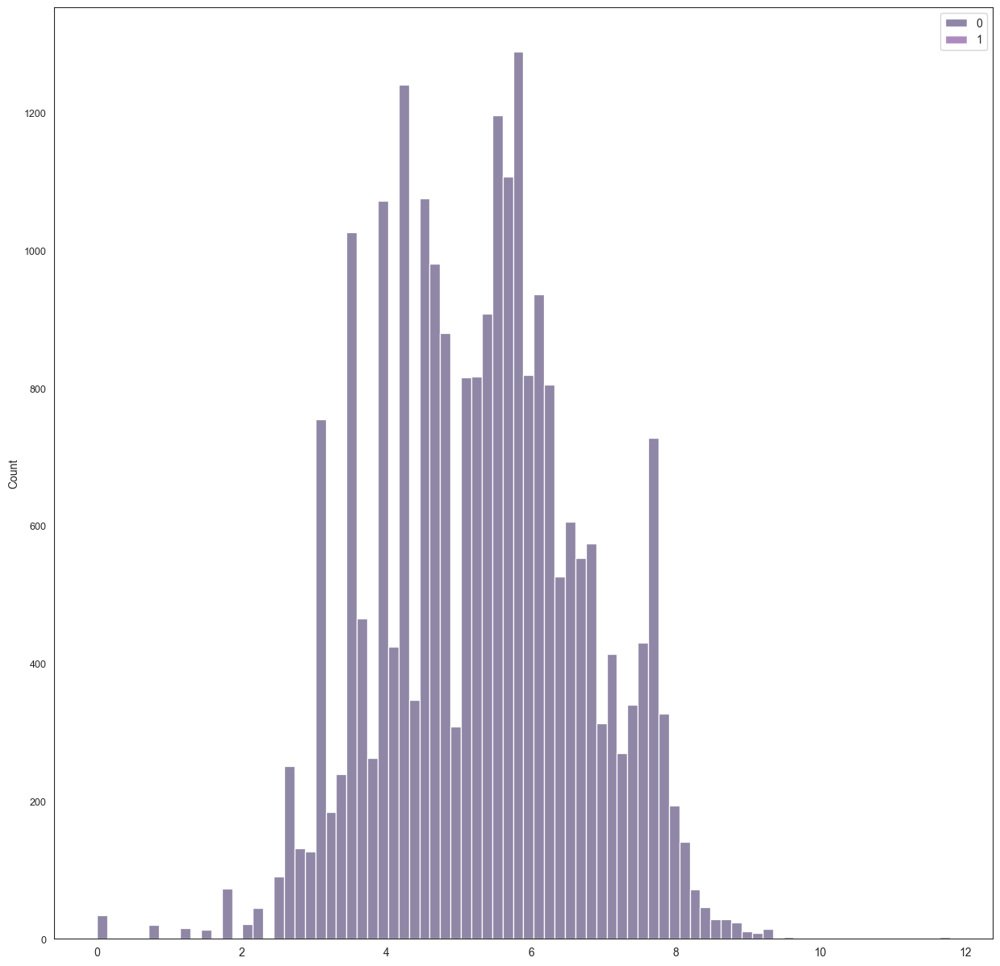

In [37]:
sns.histplot(yt_train)

In [38]:
check_azimuth_sensor = [col for col in df.columns if 'sensor_azimuth' in col]
check_azimuth_solar = [col for col in df.columns if 'solar_azimuth' in col]


In [76]:
df.query('L3_CH4_sensor_azimuth_angle.notnull()')

,Place_ID X Date,Date,Place_ID,target,target_min,target_max,target_variance,target_count,precipitable_water_entire_atmosphere,relative_humidity_2m_above_ground,...,L3_SO2_solar_azimuth_angle,L3_SO2_solar_zenith_angle,L3_CH4_CH4_column_volume_mixing_ratio_dry_air,L3_CH4_aerosol_height,L3_CH4_aerosol_optical_depth,L3_CH4_sensor_azimuth_angle,L3_CH4_sensor_zenith_angle,L3_CH4_solar_azimuth_angle,L3_CH4_solar_zenith_angle,target_cat
0,010Q650 X 2020-01-02,2020-01-02,010Q650,38.0,23.0,53.0,769.50,92,11.000000,60.200001,...,-61.752587,22.363665,1793.793579,3227.855469,0.010579,74.481049,37.501499,-62.142639,22.545118,poor
1,010Q650 X 2020-01-03,2020-01-03,010Q650,39.0,25.0,63.0,1319.85,91,14.600000,48.799999,...,-67.693509,28.614804,1789.960449,3384.226562,0.015104,75.630043,55.657486,-53.868134,19.293652,poor
9,010Q650 X 2020-01-11,2020-01-11,010Q650,24.0,16.0,32.0,279.19,85,10.396144,33.100002,...,-68.586306,28.090359,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,fair
10,010Q650 X 2020-01-12,2020-01-12,010Q650,31.0,22.0,38.0,153.08,72,12.200000,28.000000,...,-62.253749,24.637207,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,poor
11,010Q650 X 2020-01-13,2020-01-13,010Q650,25.0,17.0,41.0,286.02,90,13.600000,29.200001,...,-54.350118,21.431726,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,fair
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30510,YWSFY6Q X 2020-02-02,2020-02-02,YWSFY6Q,23.0,14.0,70.0,2351.20,72,19.269308,85.200005,...,5.491190,64.144131,1854.349384,3752.561556,0.018772,-94.925903,38.749389,-161.599964,64.901579,fair
30524,YWSFY6Q X 2020-02-16,2020-02-16,YWSFY6Q,83.0,56.0,124.0,3155.00,24,8.900001,88.700005,...,-177.807478,58.533193,1870.378418,4087.396973,0.034164,64.039513,39.289459,-177.633682,58.446751,very poor
30542,YWSFY6Q X 2020-03-05,2020-03-05,YWSFY6Q,63.0,24.0,106.0,5620.89,66,7.600000,74.800003,...,7.076088,53.270235,1855.222995,3314.133968,0.022721,-94.720330,39.619695,-157.540329,54.250513,very poor
30549,YWSFY6Q X 2020-03-12,2020-03-12,YWSFY6Q,56.0,23.0,156.0,16293.50,72,18.400000,70.000000,...,-165.828479,50.041990,1854.680335,3284.730809,0.012401,-33.540973,1.146650,-165.716652,50.088737,very poor


# Check correlations between angles 

<Axes: >

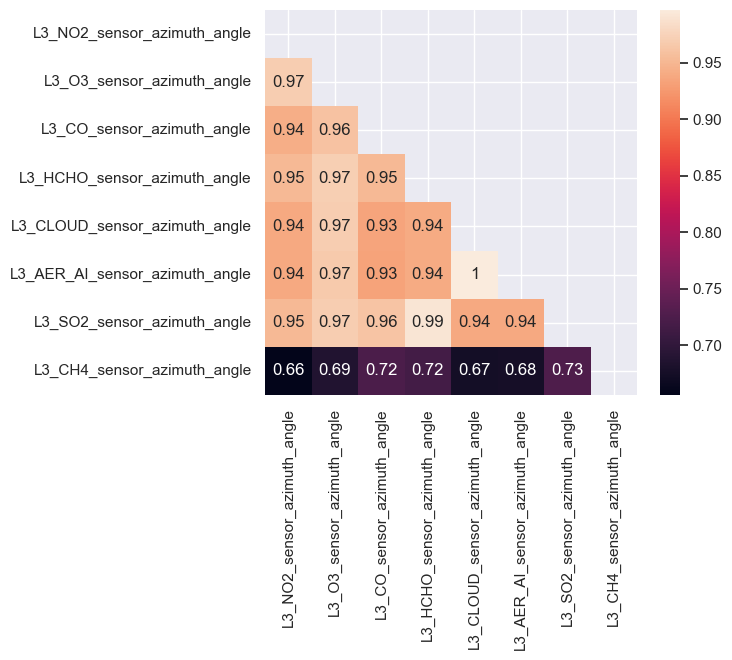

In [78]:
#corr = df[check_azimuth_sensor].corr()
corr = df.query('L3_CH4_sensor_azimuth_angle.notnull()')[check_azimuth_sensor].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(6,5)}) 
sns.heatmap(corr, annot=True, mask=matrix)

#try to do again with only including non-nans..

<Axes: >

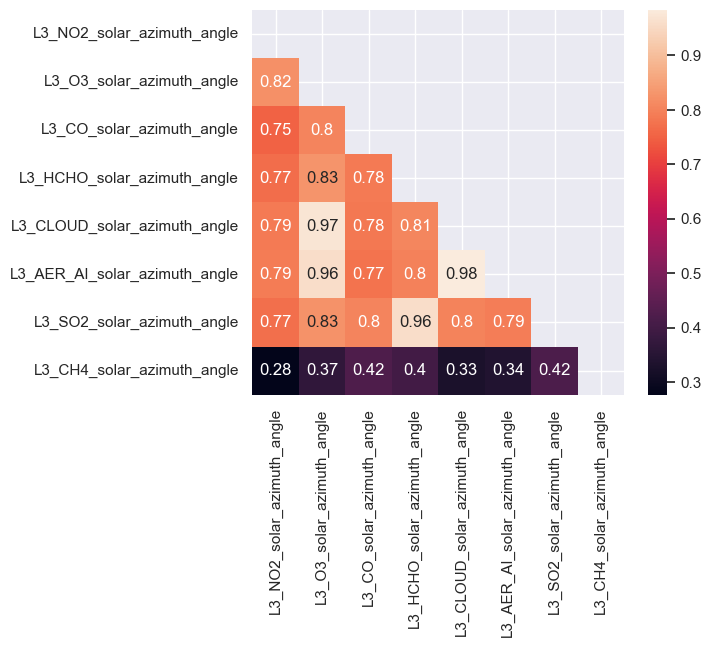

In [48]:
corr = df[check_azimuth_solar].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(6,5)}) 
sns.heatmap(corr, annot=True, mask=matrix)

In [39]:
check_zenith_sensor = [col for col in df.columns if 'sensor_zenith' in col]
check_zenith_solar = [col for col in df.columns if 'solar_zenith' in col]


<Axes: >

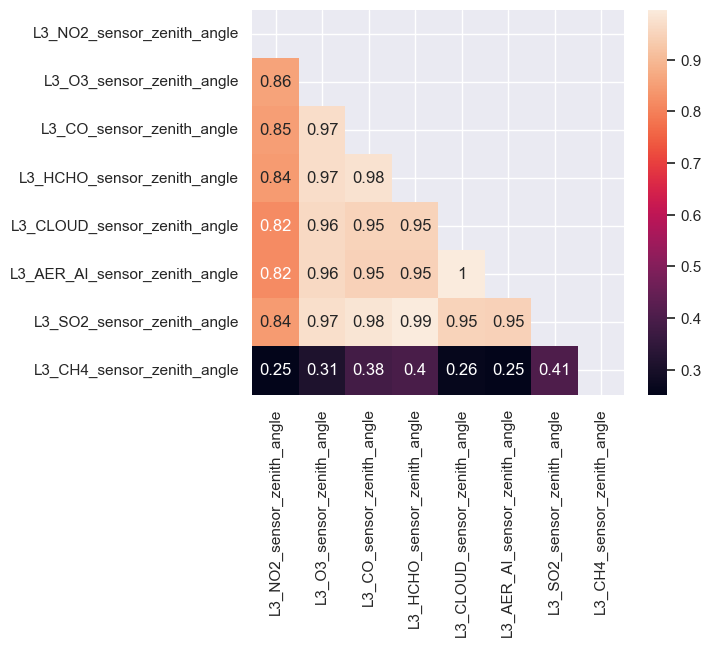

In [49]:
corr = df[check_zenith_sensor].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(6,5)}) 
sns.heatmap(corr, annot=True, mask=matrix)

<Axes: >

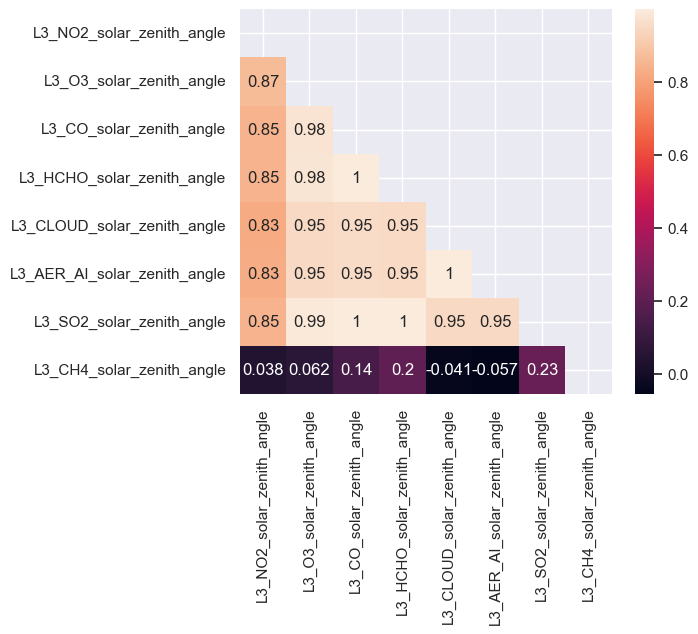

In [50]:
corr = df[check_zenith_solar].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(6,5)}) 
sns.heatmap(corr, annot=True, mask=matrix)

# Check correlations and distributions

### NO2

<Axes: >

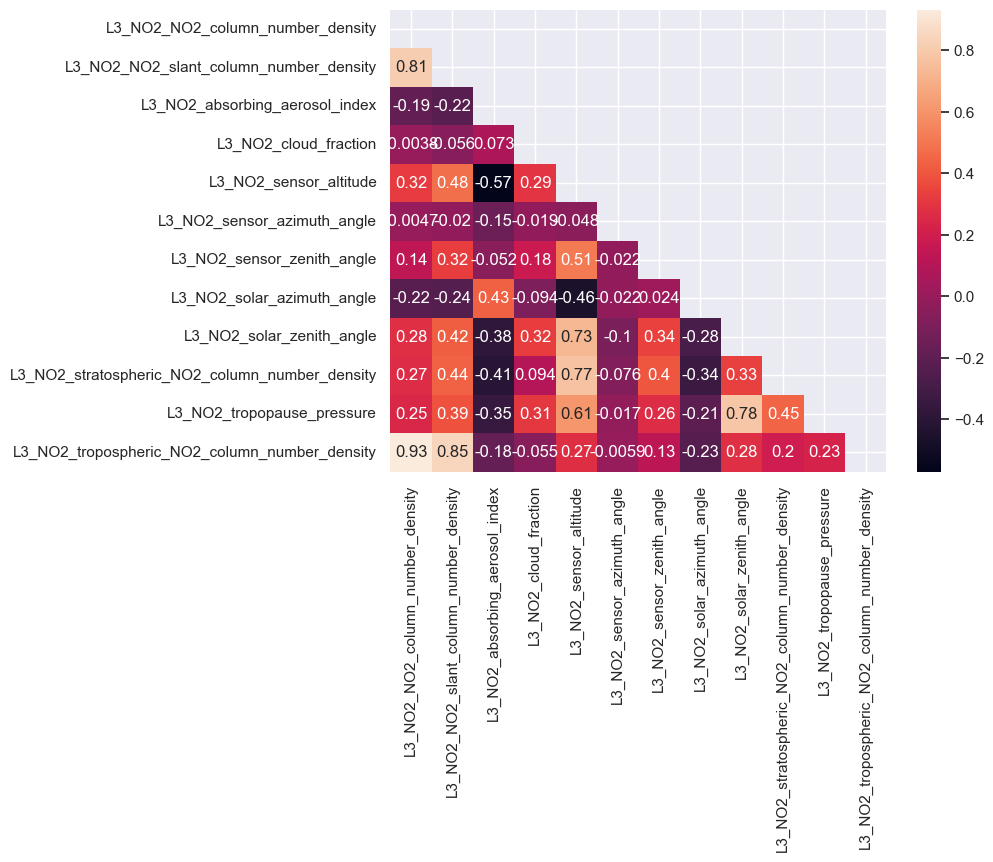

In [63]:
check_NO2 = [col for col in df.columns if 'NO2' in col]
corr = df[check_NO2].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(8,6)}) 
sns.heatmap(corr, annot=True, mask=matrix)

In [119]:
check_NO2_target

['L3_NO2_NO2_column_number_density',
 'L3_NO2_NO2_slant_column_number_density',
 'L3_NO2_absorbing_aerosol_index',
 'L3_NO2_cloud_fraction',
 'L3_NO2_sensor_altitude',
 'L3_NO2_sensor_azimuth_angle',
 'L3_NO2_sensor_zenith_angle',
 'L3_NO2_solar_azimuth_angle',
 'L3_NO2_solar_zenith_angle',
 'L3_NO2_stratospheric_NO2_column_number_density',
 'L3_NO2_tropopause_pressure',
 'L3_NO2_tropospheric_NO2_column_number_density',
 'target',
 'target_cat']

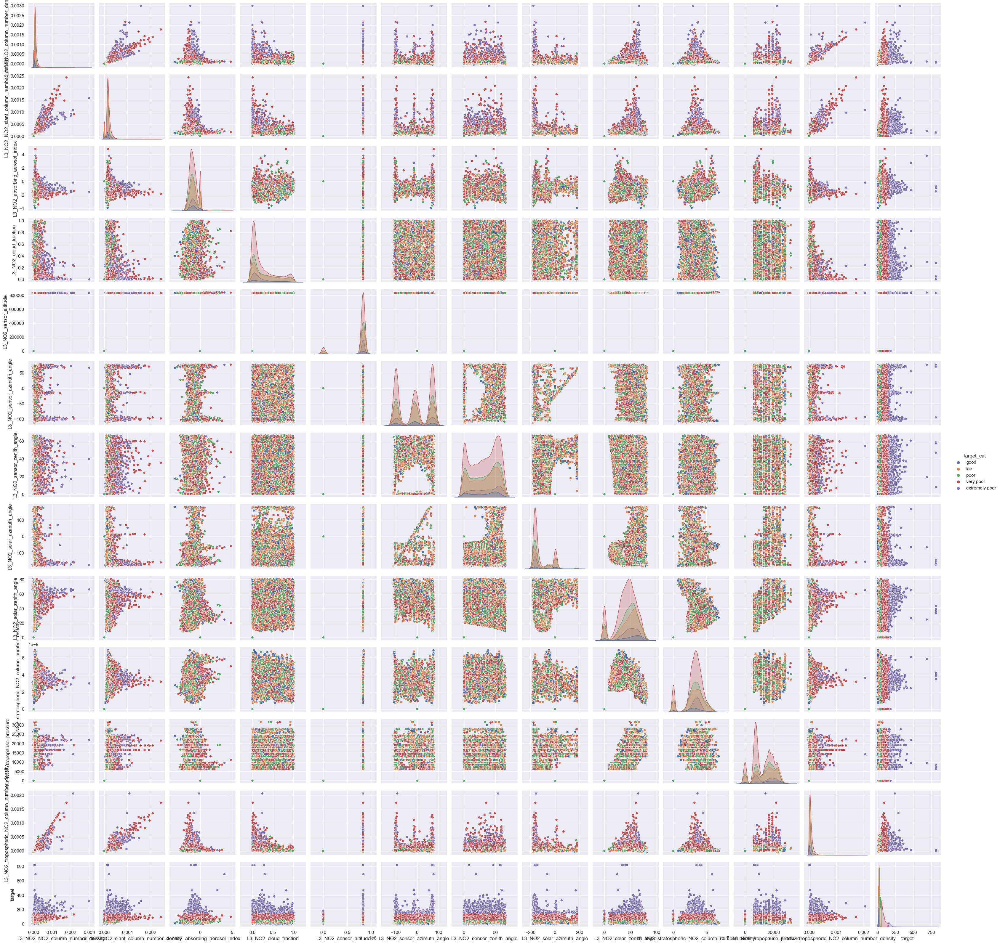

In [118]:
check_NO2_target = check_NO2 + ['target','target_cat']
sns.pairplot(data = df[check_NO2_target], hue="target_cat")

### SO2

<Axes: >

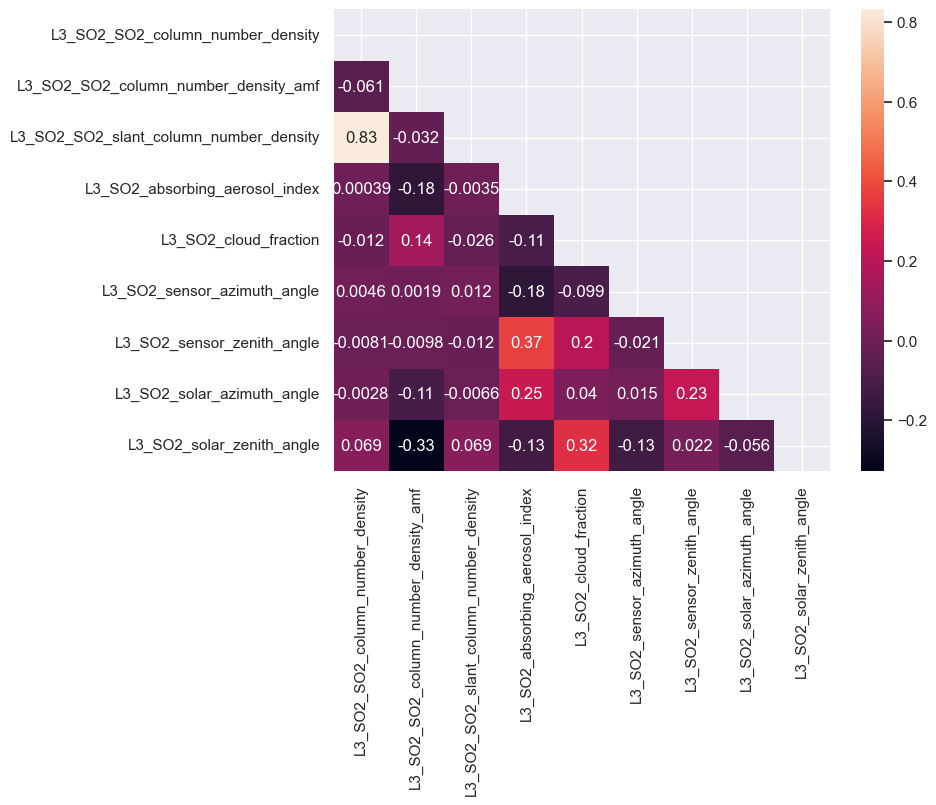

In [94]:
check_SO2 = [col for col in df.columns if 'SO2' in col]
corr = df[check_SO2].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(8,6)}) 
sns.heatmap(corr, annot=True, mask=matrix)

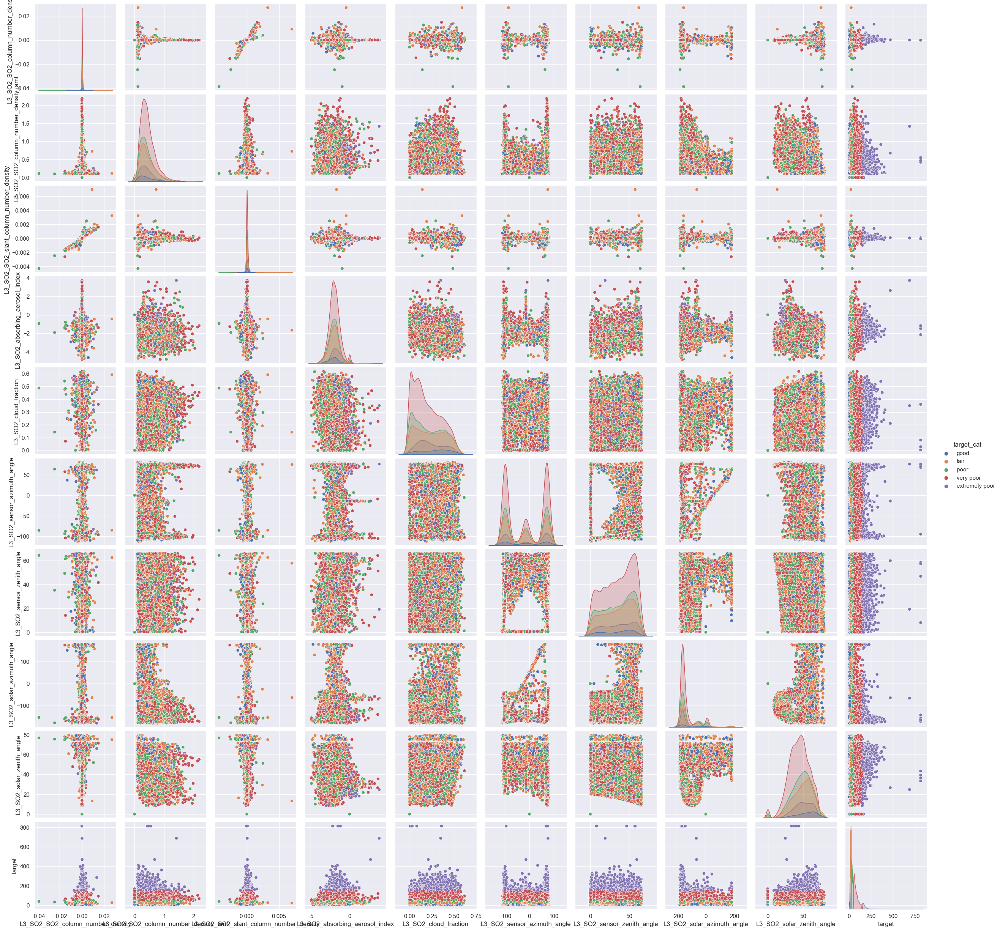

In [ ]:
check_SO2_target = check_SO2 + ['target','target_cat']
sns.pairplot(data = df[check_SO2_target], hue="target_cat")

### O3

<Axes: >

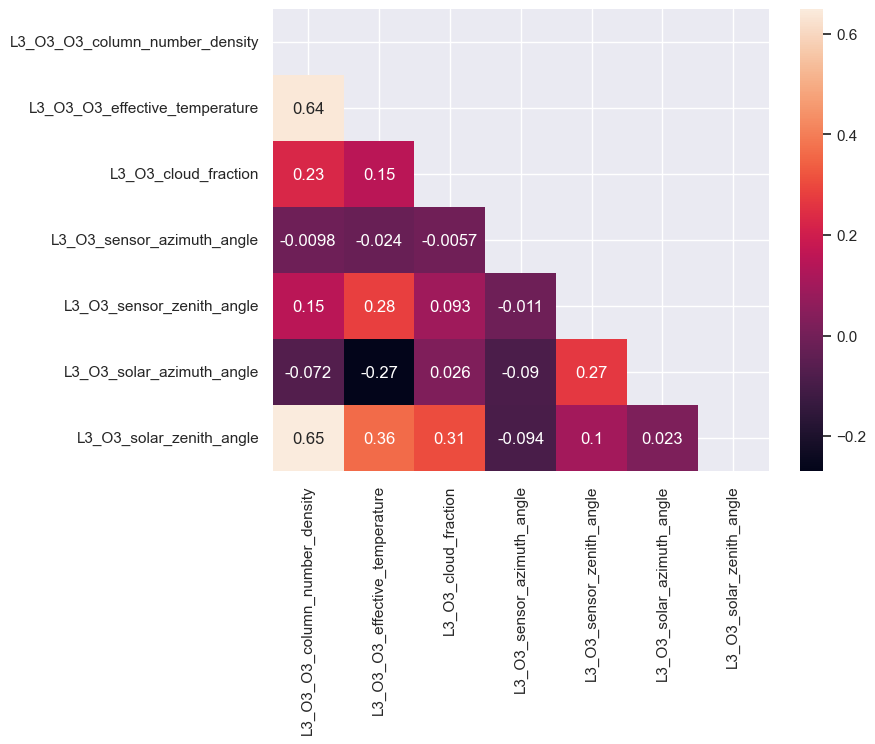

In [107]:
check_O3 = [col for col in df.columns if 'O3' in col]
corr = df[check_O3].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(8,6)}) 
sns.heatmap(corr, annot=True, mask=matrix)

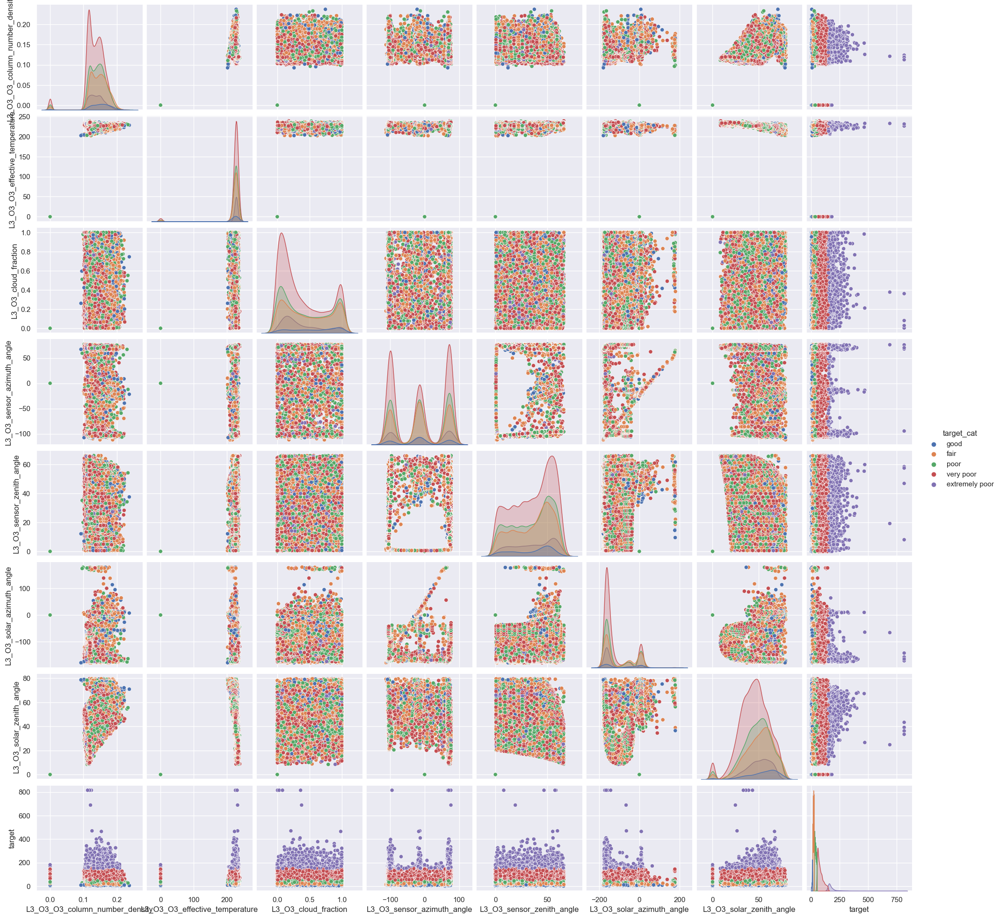

In [ ]:
check_O3_target = check_O3 + ['target','target_cat']
sns.pairplot(data = df[check_O3_target], hue="target_cat")

### CO

<Axes: >

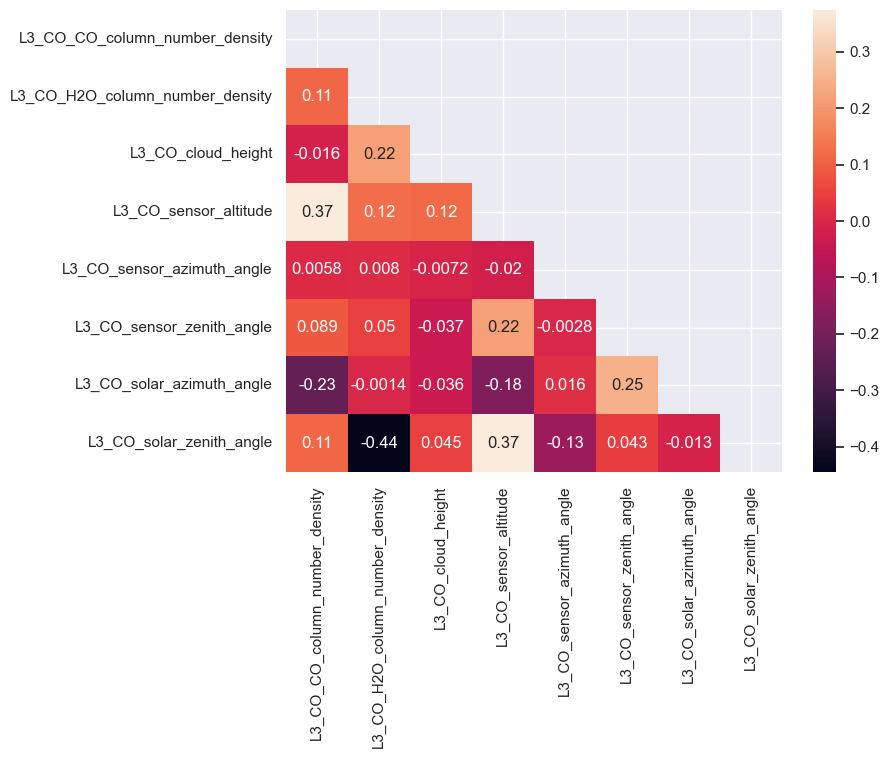

In [68]:
check_CO = [col for col in df.columns if 'CO' in col]
corr = df[check_CO].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(8,6)}) 
sns.heatmap(corr, annot=True, mask=matrix)

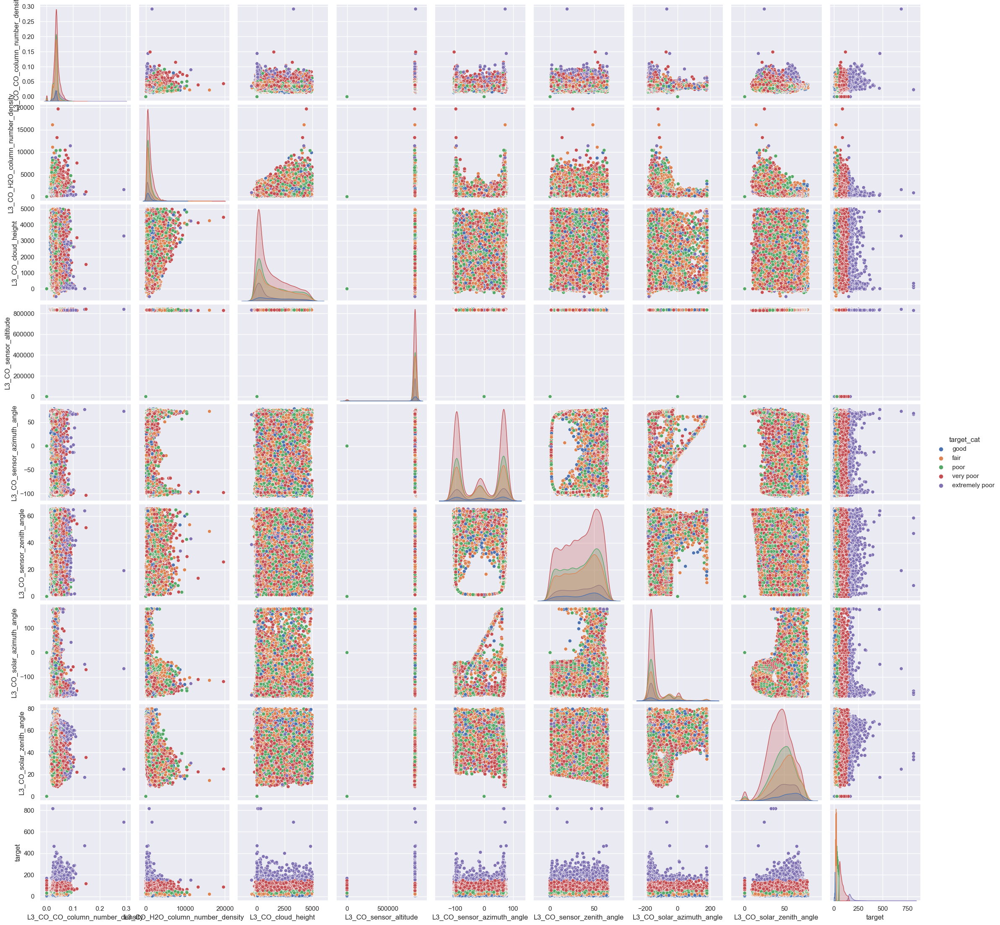

In [111]:
check_CO_target = check_CO + ['target','target_cat']
sns.pairplot(data = df[check_CO_target], hue="target_cat")

### HCHO

<Axes: >

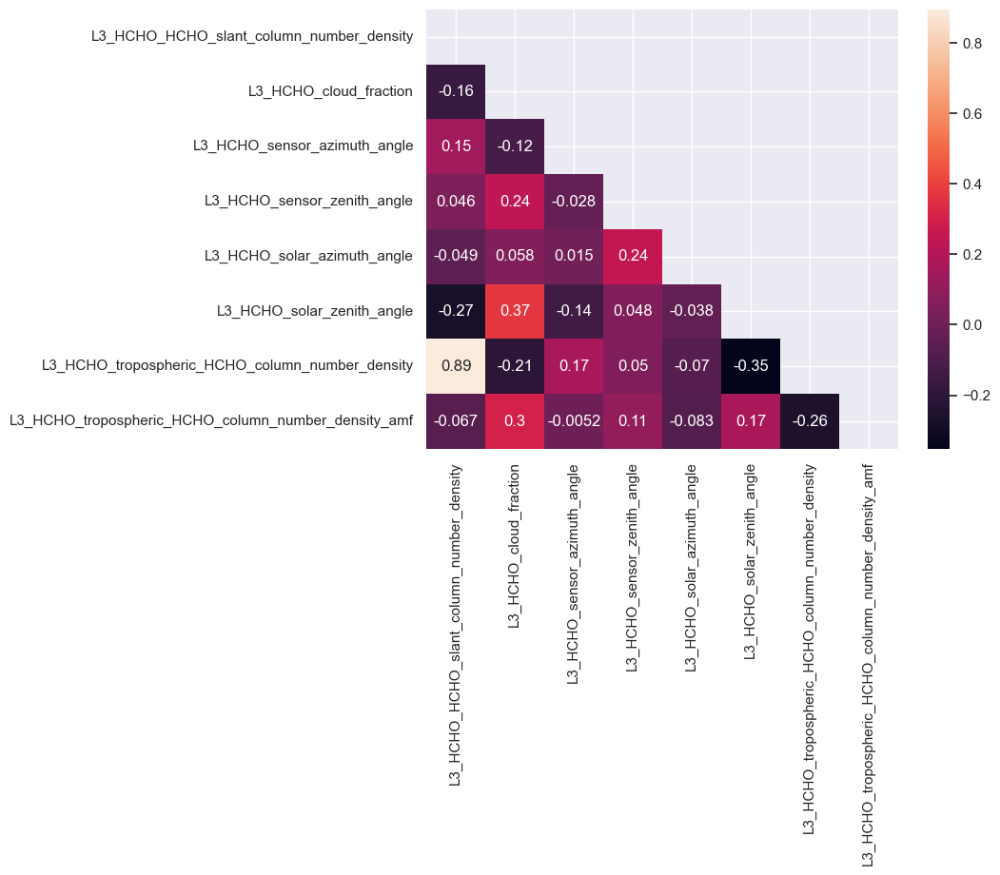

In [69]:
check_HCHO = [col for col in df.columns if 'HCHO' in col]
corr = df[check_HCHO].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(8,6)}) 
sns.heatmap(corr, annot=True, mask=matrix)

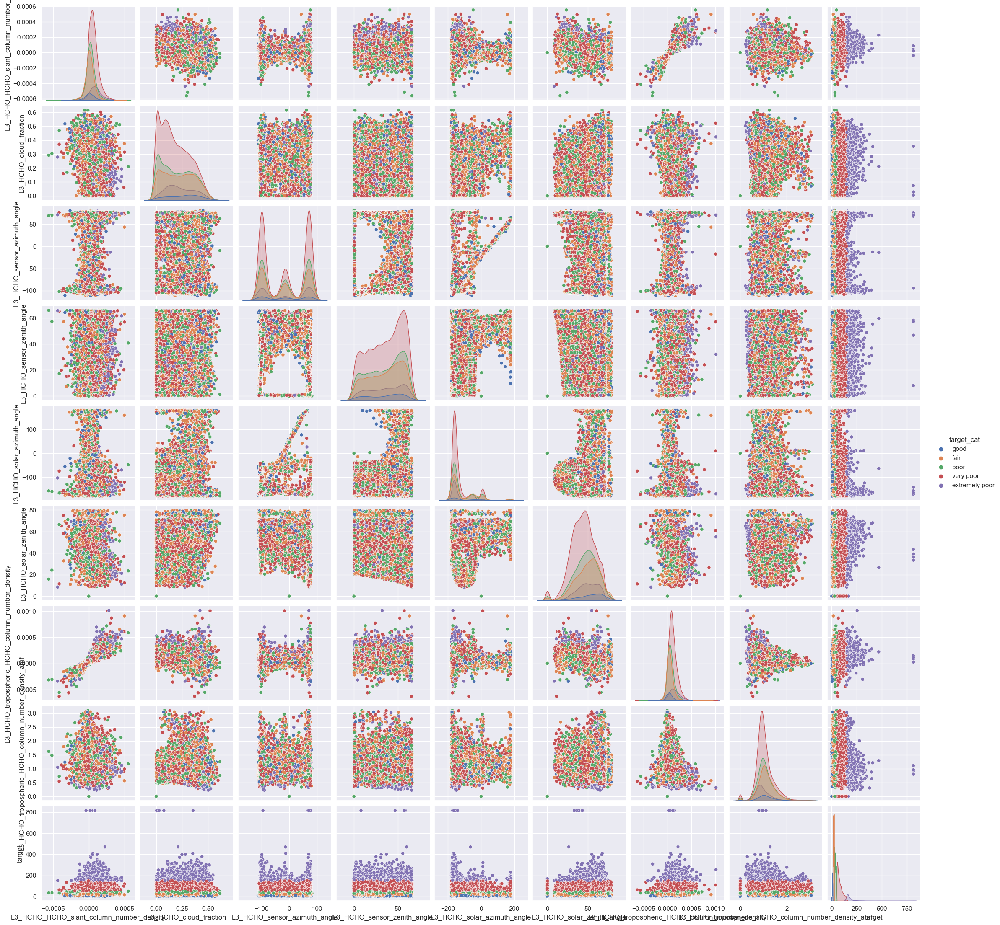

In [112]:
check_HCHO_target = check_HCHO + ['target','target_cat']
sns.pairplot(data = df[check_HCHO_target], hue="target_cat")

### AER (aerosols)

<Axes: >

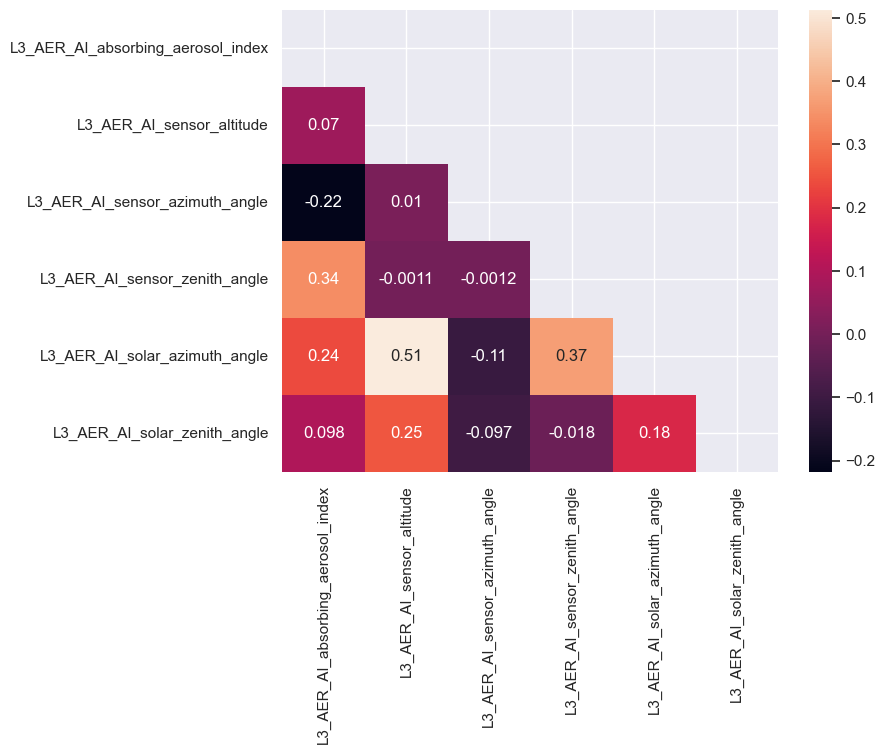

In [70]:
check_AER = [col for col in df.columns if 'AER' in col]
corr = df[check_AER].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(8,6)}) 
sns.heatmap(corr, annot=True, mask=matrix)

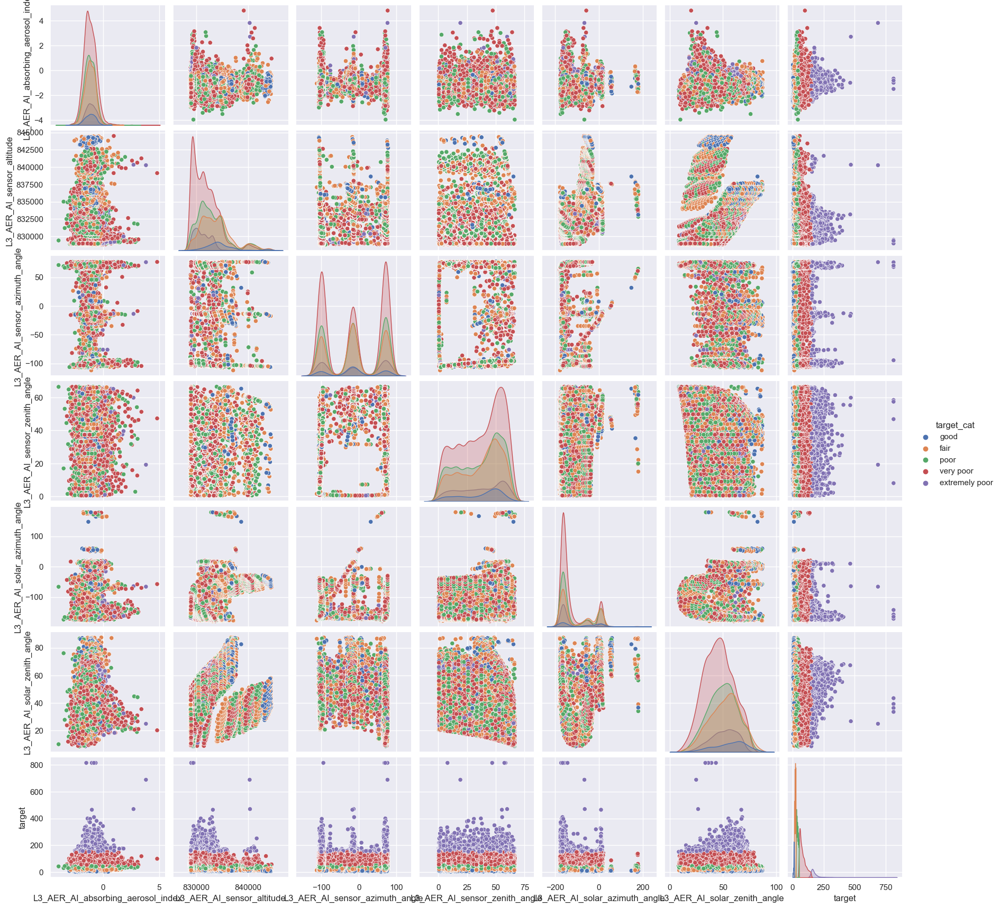

In [120]:
check_AER_target = check_AER + ['target','target_cat']
sns.pairplot(data = df[check_AER_target], hue="target_cat")

### CLOUD

<Axes: >

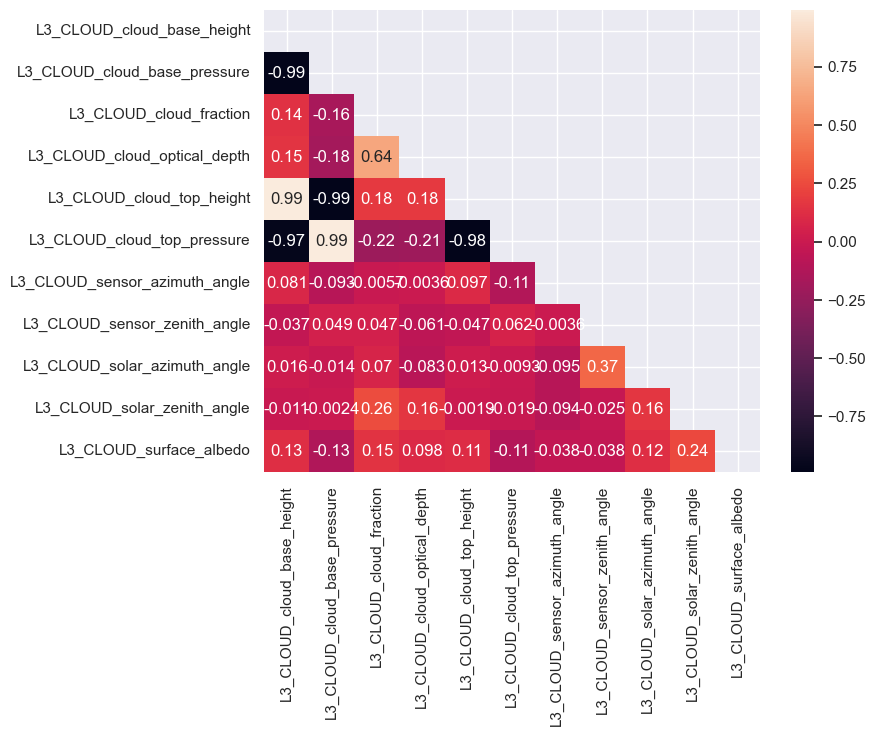

In [71]:
check_CLOUD = [col for col in df.columns if 'CLOUD' in col]
corr = df[check_CLOUD].corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corr)

# using the upper triangle matrix as mask
sns.set(rc={'figure.figsize':(8,6)}) 
sns.heatmap(corr, annot=True, mask=matrix)

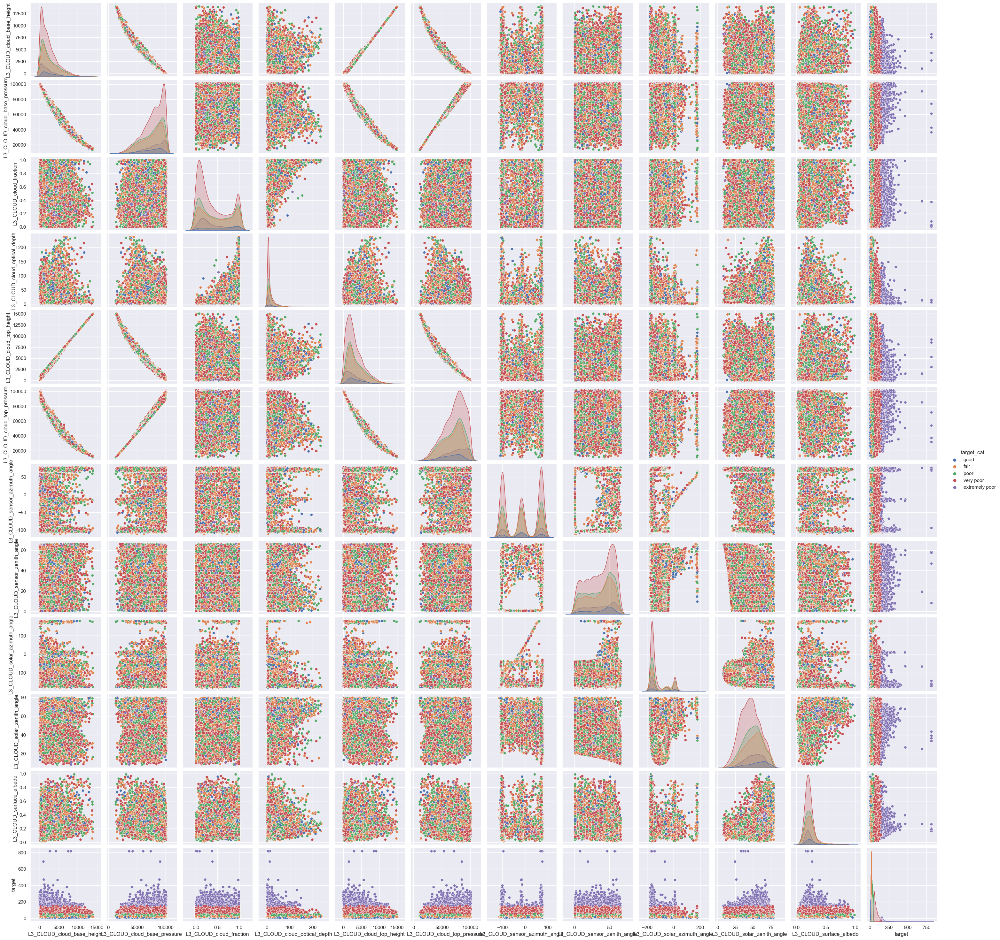

In [113]:
check_CLOUD_target = check_CLOUD + ['target','target_cat']
sns.pairplot(data = df[check_CLOUD_target], hue="target_cat")

# Check correlations of GFS and other data with satellite information

In [115]:
non_satellite = [col for col in df.columns if not 'L3' in col]
non_satellite

['Place_ID X Date',
 'Date',
 'Place_ID',
 'target',
 'target_min',
 'target_max',
 'target_variance',
 'target_count',
 'precipitable_water_entire_atmosphere',
 'relative_humidity_2m_above_ground',
 'specific_humidity_2m_above_ground',
 'temperature_2m_above_ground',
 'u_component_of_wind_10m_above_ground',
 'v_component_of_wind_10m_above_ground',
 'target_cat']

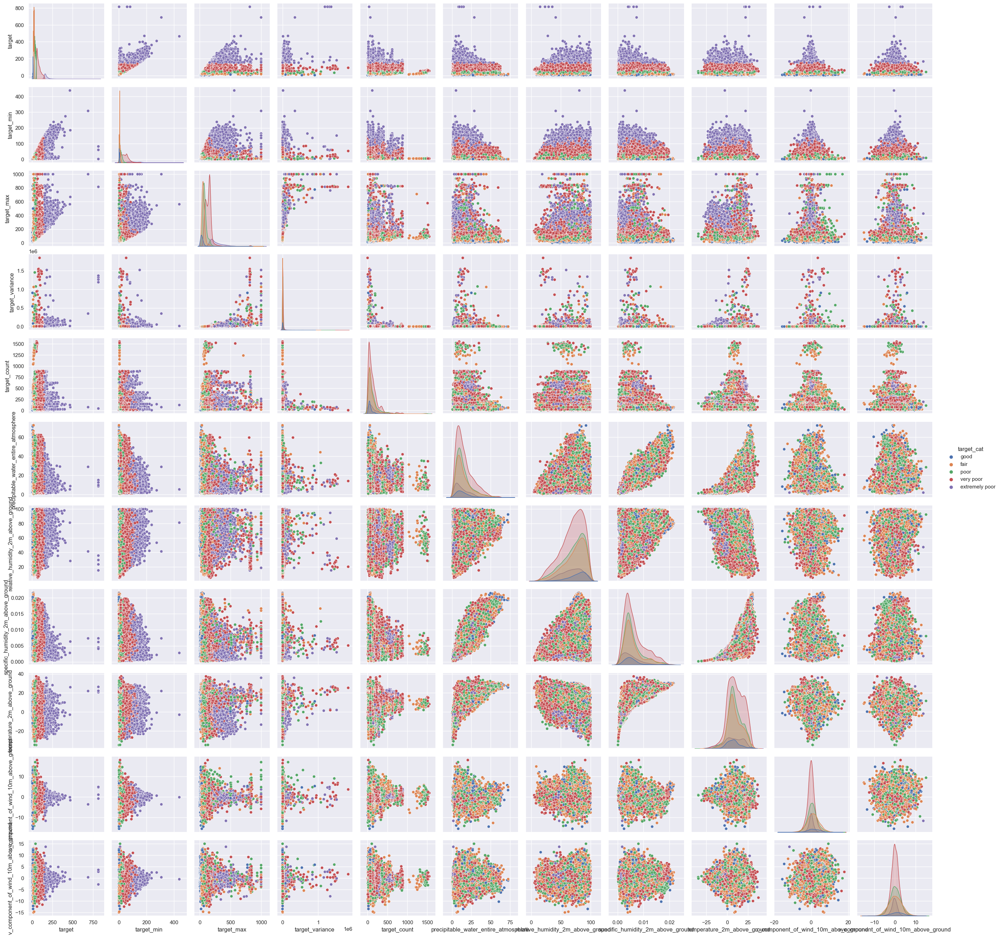

In [116]:
sns.pairplot(data = df[non_satellite], hue="target_cat")

# Cleaning data frame

- get rid of CH4 columns, too much missing data
- null values in selected features replaced by nan (so that the pipeline's imputer can handle them)

# Feature engineering

- From date to day of the week
- From date to weekend/weekday
- From Place_ID to city or location on map
- Bonus: add lag in measures